# HBr Etching w/ LOR Resist results
## 14/04/21 
### Rory Lambert, Emanuele Ghisetti

#### Setting Up Imports


In [15]:
from plotly.offline import init_notebook_mode
import plotly.graph_objects as go
init_notebook_mode()
from RLtools.data_processing.stylusprofiler.debug_tulip import generate_report, CircleStructure
from RLtools.data_processing.stylusprofiler.surfaceprofile import SurfaceProfile, add_profile_and_align
import importlib


#### Define the working directories and import the data

In [16]:
from pathlib import Path
sharepoint = os.path.join(os.path.expanduser('~'), 'CST Global Ltd')
integration_drive = os.path.join(sharepoint, 'Integration - Documents')
folder = os.path.join(integration_drive ,r'MLA2\HBr trials\Resist3')


def get_fname(f):
    return str(f).split('\\')[-1].split('.')[0]

names = [get_fname(f) for f in Path(folder, 'non etched').rglob('*.txt')]
paths = [f for f in Path(folder).rglob('*.txt')]

#profiles = [SurfaceProfile(path, name=name) for name, path in zip(names, paths)]
profiles = {name:SurfaceProfile(path, name=name)for name, path in zip(names, paths)}

## Non etched sample

1 sample that had not been etched was measured on the dektak using the 'long' test structure

In [17]:
from RLtools.Utilities.plotlyfuncs import make_transparent, draw_axes


def manual_split(df, L, R):
    sclen = 'Scan Length (um)'
    return df[df[sclen].between(L, R)], None

def manual_crop_and_fit(sp, L, R):
    xres=sp.x_resolution
    cs = CircleStructure(sp.name, sp.data)
    cs.split(f'{cs.name}: Cropped','',manual_split, L=L, R=R)
    f=go.Figure()
    cs.split1.add_trace(f)
    cs.split1.df_find_peaks(f=f, x_resolution = xres)
    cs.split1.fit_peaks(f)
    f.update_layout(width = 1200, height = 400, legend = dict(xanchor='center', x= 0.2, orientation= 'h' ))
    f=make_transparent(f)
    f=draw_axes(f)
    f.layout.xaxis['title'] = 'Scan Length (um)'
    f.layout.yaxis['title'] = 'Profile (um)'
    f.show()
    return cs

cs = manual_crop_and_fit(profiles['53'], 2000,5000)
peakdata= cs.split1.highest_peak()

peakdata.loc[:,'widths']*=profiles['53'].x_resolution
peakdata


C:\ProgramData\Anaconda3\envs\env-pecvd\lib\site-packages\pandas\core\indexing.py:1675: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Scan Length (um),Profile (um),Name,widths,heights,L,R
21398,3566.333333,8.741,53,109.610321,0.001676,6926.721159,10872.692727


We can observe that the fracturing has errored here, and the fits on the large structures are incorrect, however one can easily read from the graph that the height is between 8.7 and 8.8um. This is in good agreememt with Ross' measurement of around 8.3 to 8.4

**Edit** - I manuually cropped the data and acheived a good fit, data is displayed above


## Etched samples - pre and post resist strip
### Sample 12
#### Pre

In [18]:
pre_names = [get_fname(f) for f in Path(folder, 'Pre Strip').rglob('*.txt')]
pre_paths = [f for f in Path(folder, 'Pre Strip').rglob('*.txt')]
#pre_profiles = [SurfaceProfile(path, name=name) for name, path in zip(pre_names, pre_paths)]
pre_profiles = {name:SurfaceProfile(path, name=name)for name, path in zip(pre_names, pre_paths)}
#sample 12

f12=pre_profiles['12'].plot()
f12

Tallest peak is 21.86um, width at base approx 164um

#### Post
I had some trouble levelling number 12, so there are a few files to choose from. 

In [19]:
#read in the files
def read_files_to_dict(path, ftype, func, **fkwargs):
    outfiles = {}
    for f in Path(path).rglob(ftype):
        outfiles[get_fname(f)] = func(f, name = get_fname(f))
    return outfiles

post_profiles = read_files_to_dict(folder + '/Post Strip', '*.txt', SurfaceProfile)


In [20]:

compare_12_levelling =post_profiles['12raw'].plot()

add_profile_and_align(compare_12_levelling,  post_profiles['12level1'])
add_profile_and_align(compare_12_levelling,  post_profiles['12level2'])


KeyError: '12level1'

After comparison, the level1 and level2 look similar enough, and both look reasonable. Will just use 12level1 going forward. Lets now compare pre and post

In [ ]:
add_profile_and_align(pre_profiles['12'].plot() , post_profiles['12level1'], -325)

The plateau height is 14.6 um, width is around 150um, looks very similar to before

## Sample 22
### Pre

In [ ]:

s22pre = pre_profiles['22'].plot()
_ = manual_crop_and_fit(pre_profiles['22'],2790,5600)



### Post
Microgprahs from after resist strip (1x ash)


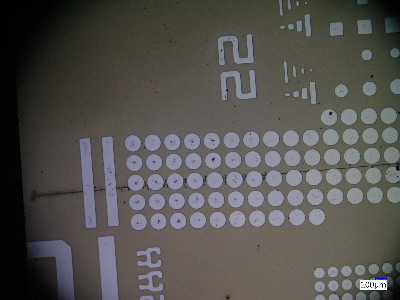

In [23]:

def get_thumbs_from_folder(impath, ftype='*jpg', downscale=4):
    from PIL import Image
    impaths = [f for f in impath.rglob(ftype)]
    imnames = [get_fname(f) for f in impaths]
    imdict = {name:Image.open(path) for name, path in zip(imnames, impaths)}
    for key, val in imdict.items():
        imdict[key] = val.resize((int(val.size[0]/downscale),int(val.size[1]/downscale)), 0) 
    return imdict

### first attempt at stripping
p1 = Path(folder, 'Post Strip', 'Images')
post_strip_images = get_thumbs_from_folder(p1)
#im['22a']
post_strip_images['22a']

Had some difficulty with the levelling of the full trace;


In [24]:
post_profiles['22_nonsense'].plot()

So instead used a single lens scan

In [ ]:
post_profiles['22_single'].plot()

In [ ]:
#Now lets align them
add_profile_and_align(s22_pre,post_profiles['22_single'],4147-162, -0.47)

I think it is safe to assume all the resist has been stripped from this sample given the shape of the plateau. Therefore I've aligned the trace -500nm, and would report this as the height of the plateua, with negligible resist erosion for this sample



## Sample 23
### Pre


In [ ]:

c_obj, plist = generate_report(pre_profiles['23'], makefig= True)

In [ ]:
plist

The fitting worked nicely for this sample. I guess with a pre-measurement of 8-9 um the etch depth as not been particularly deep for this sample either.

### Post strip


In [ ]:
post_strip_images['23a']

In [ ]:
s23pre=pre_profiles['23'].plot()
add_profile_and_align(s23pre, post_profiles['23'],  -29, -0.6)
s23pre.update_xaxes(range =[1550, 2150])

Again, the flat profile would indicate the removal of all of the resist, with a resulting plateau of around 600nm


## Sample 24
### Pre vs post

In [ ]:
s24 = pre_profiles['24'].plot()
add_profile_and_align(s24, post_profiles['24'], -1252, -0.52)
s24.update_xaxes(range =[3300, 4100])

Another sample in which the resist appears to have been fully removed. The etch depth is estimated as **500nm**

## Sample 31
### Pre




In [ ]:
pre_profiles['31']
s31, s31peaks = generate_report(pre_profiles['31'], makefig=True)

In [ ]:
s31peaks

Auto peak detection here has been a little bit wacky. Can anyway tell that the tallest peak is around **8.8um**, indicating that this sample has not experienced significant etched.

### Post
About 4.4um of etching.

In [26]:
s31compare = add_profile_and_align(pre_profiles['31'].plot(), post_profiles['31'], 3700-698-70)
s31compare.update_xaxes(range = [4600, 5200])

def show_substrate(f, y1):
    return f.add_hrect(-1, y1, line_width=0, fillcolor='green',opacity =0.2, name='substrate')

show_substrate(s31compare, 0.43)

## Sample 32
### Pre strip


In [ ]:
pre_profiles['32'].plot()


In [ ]:

_ = manual_crop_and_fit(pre_profiles['32'], L=3126, R=5100)

Peak height of **15.5um**, with approx 7.6um of resist remaining and perhaps a 7.7um deep etch. Assume remaining 0.2um is a zeroing error.

### Post resist strip

In [ ]:
post32_fig =post_profiles['32'].plot()
post32_fig

In [ ]:
_ = manual_crop_and_fit(post_profiles['32'], 4150, 6300)

Peak height is 15.49um, which is almost exactly the same as before the resist strip. It seems likely that the resist has not been removed on this sample. If you check the form of a single peak (i.e zoom 5000 to 5200 in x), its clear that there is a transition from straght sidewalls to curved 'cap'. We can have a quick look at the derivative signal to see how this manifest;


In [35]:
post32 = CircleStructure(post_profiles['32'].name, post_profiles['32'].data)
deriv_figure = post32.compute_derivative(5, 1, makefig=True)
deriv_figure

deriv_figure.update_layout(width = 1200, height=600, legend = dict(xanchor='center', x= 0.2, orientation= 'h' ))
f=make_transparent(deriv_figure)
f=draw_axes(f)
f.layout.xaxis['title'] = 'Scan Length (um)'
f.layout.yaxis['title'] = 'Profile (um)'
f.layout.yaxis2['title'] = 'Derivative (um/)'
f

Finally, lets align this trace with the pre-strip and compare them all. 

In [ ]:
add_profile_and_align(deriv_figure, pre_profiles['32'], 1074-43)

## Sample 33
### Pre strip
At 8.97um tallest peak, looks like negligible etching here also

In [13]:
_ = manual_crop_and_fit(pre_profiles['33'], 2282, 4500)



### Post strip



In [29]:
s33_comparison = add_profile_and_align(pre_profiles['33'].plot(), post_profiles['33'], -383)
s33_comparison.update_xaxes(range=[2000, 4750])
show_substrate(s33_comparison, 0.38)

s33d = CircleStructure(pre_profiles['33'].name, pre_profiles['33'].data)
deriv_figure = s33d.compute_derivative(5, 1, makefig=True)
deriv_figure.update_layout(width = 1200, height=600, legend = dict(xanchor='center', x= 0.2, orientation= 'h' ))
f=make_transparent(deriv_figure)
f=draw_axes(f)
f.layout.xaxis['title'] = 'Scan Length (um)'
f.layout.yaxis['title'] = 'Profile (um)'
f.layout.yaxis2['title'] = 'Derivative (um/)'
f

## Sample 34
### Pre Strip

With a peak of around 9.46um, we can estimate that some etching has occurred, although the single-lens profile does not show an abrupt transition from sidewalls to cap

In [ ]:
_ = manual_crop_and_fit(pre_profiles['34'], 2400, 5000)

We can check the derivative too;


In [ ]:
pre34 = CircleStructure(pre_profiles['34'].name, pre_profiles['34'].data)
deriv_figure = pre34.compute_derivative(5, 1, makefig=True)
deriv_figure.update_xaxes(range=[3300, 4000])

### Post Strip
This is another sample where the etching was limited, and the levelling was a challenge. It looks like other than some spikes caused by residues, the resist has been removed, leaving plateaus of ~70nm height 

In [ ]:
s34_comparison =add_profile_and_align(pre_profiles['34'].plot(), post_profiles['34'], 60)
s34_comparison.update_xaxes(range=[2400,5000])
show_substrate(s34_comparison, 0.07)

## Sample 43
### Pre

Peak of **18.4um** is massive, especially if this sample was only etched once. Zooming in shows very vertical sidewalls and very minimal resist erosion. The derivative highlights the change in profile even more

In [ ]:

s43pre = manual_crop_and_fit(pre_profiles['43'], 800, 3879)
print(f'Looks like {18.45-10.33}um resist remain on top of a {10.33-0.2}um plateau')

In [ ]:
s43p = CircleStructure(pre_profiles['43'].name, pre_profiles['43'].data)
deriv_figure = s43p.compute_derivative(5, 1, makefig=True)
deriv_figure.update_xaxes(range=[2000, 2500])

In [ ]:
f=go.Figure()
add_profile_and_align(f,pre_profiles['43'], 0, -0.2)
add_profile_and_align(f,post_profiles['43'], -2135 -351-10)
show_substrate(f, 10)
f.update_xaxes(range=[1800,2400])

## Sample 44
### Pre

Looks like a 9.1um peak, indicating about 300nm of etching. Zooming in to one peak does not show a steep sidewall.

In [ ]:
s44pre = manual_crop_and_fit(pre_profiles[12], 2000, 4500)

## Sample 45
### Pre
Has a 13.6um peak, and shows drastic pedestal effect. 

In [ ]:
s45pre = manual_crop_and_fit(pre_profiles[13], 3500, 5500)
print(f'Resist remaining: {13.6-5.9:.2f}um, Pedestal Depth {5.9-0.3:.2f}um')

## Sample 52
### Pre

Max peak of 10.3um 

In [ ]:
s52pre = manual_crop_and_fit(pre_profiles[14], 3500, 5500)

## Post
Have not scanned, as 

## Sample 41
**Both traces I took for this sample just look weird, and it's not obvious how to level or process them.
I would say the top peak is about 11.6um high, and there is about 4um of plateau-ing. 


In [ ]:
s41pre = manual_crop_and_fit(pre_profiles[9], 000, 45000)

In [ ]:
s41pre = manual_crop_and_fit(pre_profiles[10], 000, 45000)